<a href="https://colab.research.google.com/github/Justus-coded/Competitions/blob/master/Expresso_Churn_Prediction%20Challenge.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Importing libraries

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display


import warnings
warnings.filterwarnings("ignore")

# Set all options
%matplotlib inline
plt.style.use('seaborn-notebook')
plt.rcParams["figure.figsize"] = (20, 3)
pd.options.display.float_format = '{:20,.4f}'.format
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
sns.set(context="paper", font="monospace")

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


### User defined functions

In [5]:
def quality_report(df):
    """
    Description: Displays quality of data in terms of missing values, unique numbers, datatypes etc.
    Arguments: Dataframe
    """
    dtypes = df.dtypes
    nuniq = df.T.apply(lambda x: x.nunique(), axis=1)
    total = df.isnull().sum().sort_values(ascending = False)
    percent = (df.isnull().sum()/df.isnull().count()*100).sort_values(ascending = False)
    quality_df  = pd.concat([total, percent, nuniq, dtypes], axis=1, keys=['Total', 'Percent','Nunique', 'Dtype'])
    display(quality_df)


def object_count_plot(df):
    """
    Description : Plot countplot for all categorical features present in the dataframe passed
    Argument : Dataframe
    """
    
    for var in df.columns:
        if df[var].dtype == 'object':
            print(df[var].value_counts())
            plt.figure(figsize=(12,5))
            g = sns.countplot(x=var,data=df)
            g.set_xticklabels(g.get_xticklabels(), rotation=90, ha="right")
            plt.tight_layout()
            plt.show()
            
def numeric_distribution_plot(df):
    """
    Description : Gives distribution plot for all the numeric features in the dataframe passed
    Argument : Dataframe
    """
    for col in df.columns:
        if df[col].dtype != 'object':
            print(df[col].describe())
            plt.figure(figsize=(12,5))
            plt.title("Distribution of "+col)
            ax = sns.distplot(df[col].dropna())
            plt.tight_layout()
            plt.show()

### Importing data

In [6]:
train = pd.read_csv('/content/drive/My Drive/DSN Pre-Bootcamp Hackathon - Expresso Churn Prediction/Train.csv')
test = pd.read_csv('/content/drive/My Drive/DSN Pre-Bootcamp Hackathon - Expresso Churn Prediction/Test.csv')
sub = pd.read_csv('/content/drive/My Drive/DSN Pre-Bootcamp Hackathon - Expresso Churn Prediction/sample_submission.csv')

In [7]:
train.set_index('user_id', inplace = True)
test.set_index('user_id',inplace=True)

In [8]:
print("Shape of train = ",train.shape)
print("Shape of test = ",test.shape)
print("Shape of Sample sub = ",sub.shape)

Shape of train =  (400000, 18)
Shape of test =  (100000, 17)
Shape of Sample sub =  (100000, 2)


In [9]:
train.sample(5)

,REGION,TENURE,MONTANT,FREQUENCE_RECH,REVENUE,ARPU_SEGMENT,FREQUENCE,DATA_VOLUME,ON_NET,ORANGE,TIGO,ZONE1,ZONE2,MRG,REGULARITY,TOP_PACK,FREQ_TOP_PACK,CHURN
user_id,,,,,,,,,,,,,,,,,,
65d0b5ce79280bb3e356cdcc9a5f92c373aef18b,THIES,K > 24 month,200.0000,1.0000,200.0000,67.0000,1.0000,"1,024.0000",8.0000,nan,0.0000,nan,nan,NO,9,On net 200F=Unlimited _call24H,1.0000,0
5b9597b92c003ffb615c85d8014ec0bd139ba042,NaN,K > 24 month,nan,nan,6.0000,2.0000,1.0000,nan,nan,nan,nan,nan,nan,NO,4,NaN,nan,0
00de8f107314af69fd1c4a336dc68c1df7939e21,DAKAR,K > 24 month,500.0000,4.0000,500.0000,167.0000,10.0000,1.0000,1.0000,1.0000,nan,0.0000,0.0000,NO,23,"Data: 100 F=40MB,24H",1.0000,0
0670d4bf5a8e9c19bf2c31fc4b7c6a5d193c708a,NaN,K > 24 month,"13,500.0000",25.0000,"14,017.0000","4,672.0000",30.0000,1.0000,87.0000,461.0000,0.0000,nan,nan,NO,53,All-net 500F=2000F;5d,22.0000,0
7124b26fa3b00e4267c59a74d9883ae47e53423a,KAOLACK,K > 24 month,"13,500.0000",25.0000,"14,000.0000","4,667.0000",24.0000,0.0000,37.0000,412.0000,35.0000,20.0000,nan,NO,49,All-net 500F=2000F;5d,28.0000,0


### Checking target distribution

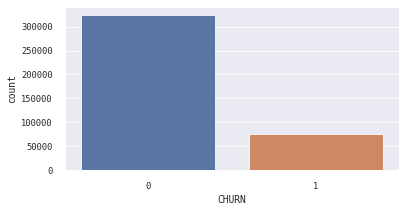

In [10]:
plt.figure(figsize=(6,3))
sns.countplot(x='CHURN',data=train)
plt.show()

In [11]:
# Percentage Churn
train['CHURN'].value_counts(normalize = True) * 100

0                81.2890
1                18.7110
Name: CHURN, dtype: float64

In [12]:
# Checking the attribute names
train.columns

Index(['REGION', 'TENURE', 'MONTANT', 'FREQUENCE_RECH', 'REVENUE',
       'ARPU_SEGMENT', 'FREQUENCE', 'DATA_VOLUME', 'ON_NET', 'ORANGE', 'TIGO',
       'ZONE1', 'ZONE2', 'MRG', 'REGULARITY', 'TOP_PACK', 'FREQ_TOP_PACK',
       'CHURN'],
      dtype='object')

In [13]:
# description = pd.read_csv('VariableDefinitions.csv')
# description

### Checking Data Quality

In [14]:
# checking missing data
quality_report(train)

,Total,Percent,Nunique,Dtype
ZONE2,374487,93.6218,255,float64
ZONE1,368310,92.0775,319,float64
TIGO,239386,59.8465,805,float64
DATA_VOLUME,196854,49.2135,22229,float64
TOP_PACK,167329,41.8323,111,object
FREQ_TOP_PACK,167329,41.8323,170,float64
ORANGE,166317,41.5793,2072,float64
REGION,157520,39.3800,14,object
ON_NET,145819,36.4548,5996,float64
FREQUENCE_RECH,140277,35.0693,111,float64


* ```MRG``` contains only a single unique value
* A significant percentage of the data contains missing values, Dropping them will make us lose significant information 
* The percetage of ```ZONE1``` and ```ZONE2``` is way too much, We should probably drop it.

In [15]:
train['MRG'].value_counts()

NO    400000
Name: MRG, dtype: int64

In [16]:
train.drop(['ZONE1', 'ZONE2','MRG'], axis = 1, inplace = True)
test.drop(['ZONE1', 'ZONE2', 'MRG'], axis = 1, inplace = True)

### Missing Value Treatment

* filling missing values in numneric features with their median (median is more resistant to outliers) 
* missing values in Categorical features will be treated as different category

In [17]:
test['CHURN'] = 'test' #for easy separation

# Combine train and test to avoid repetition
data = pd.concat([train, test]).reset_index(drop=True)

In [18]:
data.shape, train.shape, test.shape

((500000, 15), (400000, 15), (100000, 15))

In [19]:
missing_col = data.columns[data.isna().any()]

In [20]:
missing_col

Index(['REGION', 'MONTANT', 'FREQUENCE_RECH', 'REVENUE', 'ARPU_SEGMENT',
       'FREQUENCE', 'DATA_VOLUME', 'ON_NET', 'ORANGE', 'TIGO', 'TOP_PACK',
       'FREQ_TOP_PACK'],
      dtype='object')

In [21]:
# filling NaN values in numeric features
for col in missing_col.drop(['REGION', 'TOP_PACK']):
    
    data[col].fillna(data[col].median(), inplace = True)

In [22]:
# filling NaN values in numeric features
for col in [ 'TOP_PACK', 'REGION']:
    
    data[col].fillna(col+'_NAN',inplace = True)

In [23]:
data.isna().sum()

REGION            0
TENURE            0
MONTANT           0
FREQUENCE_RECH    0
REVENUE           0
ARPU_SEGMENT      0
FREQUENCE         0
DATA_VOLUME       0
ON_NET            0
ORANGE            0
TIGO              0
REGULARITY        0
TOP_PACK          0
FREQ_TOP_PACK     0
CHURN             0
dtype: int64

## Quick EDA

### Count plot

DAKAR          95517
THIES          33374
SAINT-LOUIS    22125
LOUGA          18513
KAOLACK        18042
DIOURBEL       12576
TAMBACOUNDA    10273
KAFFRINE        8181
KOLDA           7204
FATICK          6638
MATAM           5255
ZIGUINCHOR      4012
SEDHIOU          589
KEDOUGOU         181
Name: REGION, dtype: int64


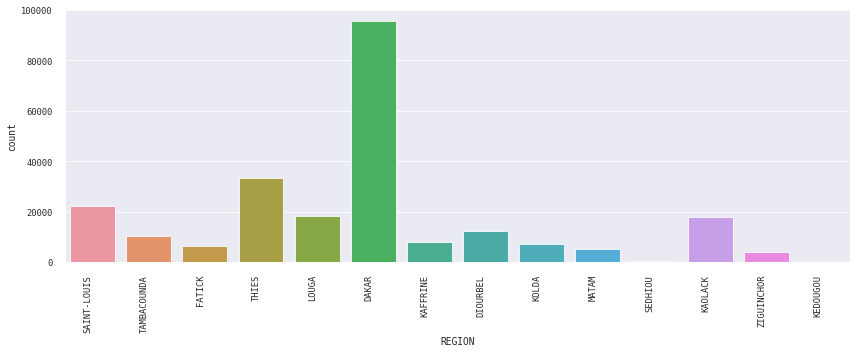

K > 24 month     379439
I 18-21 month      8312
H 15-18 month      4858
G 12-15 month      2788
J 21-24 month      2325
F 9-12 month       1771
E 6-9 month         359
D 3-6 month         148
Name: TENURE, dtype: int64


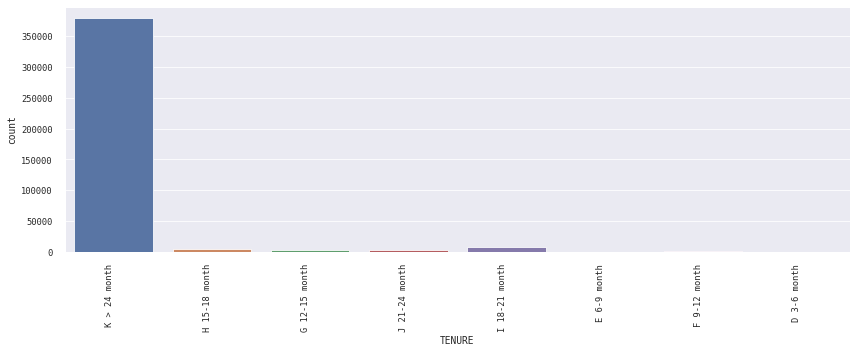

In [24]:
object_count_plot(train.drop('TOP_PACK', axis = 1))

### Distribution Plot

count           259,723.0000
mean              5,522.9713
std               7,099.6406
min                  20.0000
25%               1,000.0000
50%               3,000.0000
75%               7,300.0000
max             226,550.0000
Name: MONTANT, dtype: float64


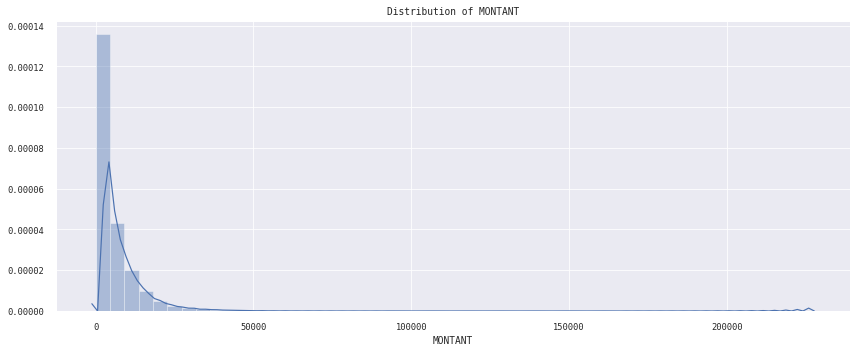

count           259,723.0000
mean                 11.5037
std                  13.2755
min                   1.0000
25%                   2.0000
50%                   6.0000
75%                  15.0000
max                 133.0000
Name: FREQUENCE_RECH, dtype: float64


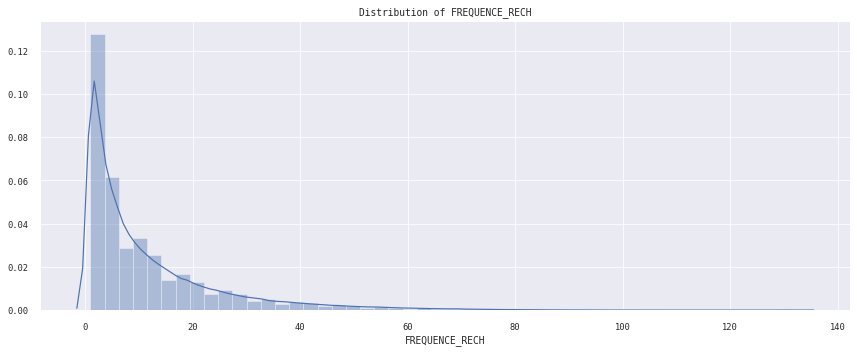

count           265,337.0000
mean              5,505.4878
std               7,175.8024
min                   1.0000
25%               1,000.0000
50%               3,000.0000
75%               7,340.0000
max             233,413.0000
Name: REVENUE, dtype: float64


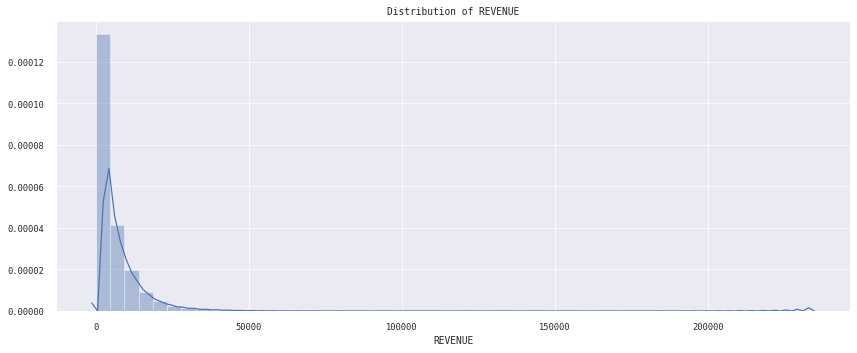

count           265,337.0000
mean              1,835.1677
std               2,391.9293
min                   0.0000
25%                 333.0000
50%               1,000.0000
75%               2,447.0000
max              77,804.0000
Name: ARPU_SEGMENT, dtype: float64


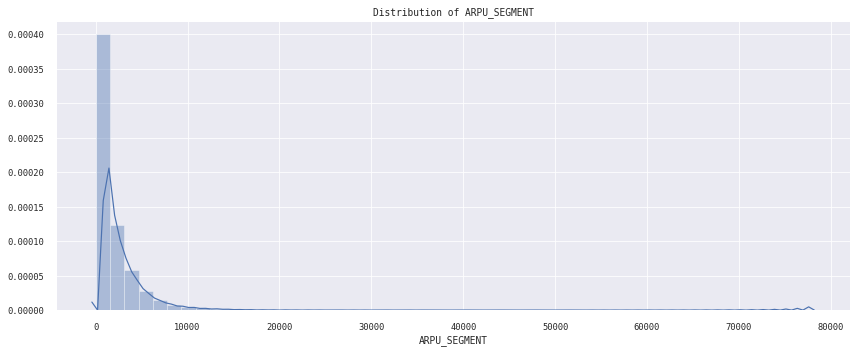

count           265,337.0000
mean                 13.9518
std                  14.6799
min                   1.0000
25%                   3.0000
50%                   9.0000
75%                  19.0000
max                  91.0000
Name: FREQUENCE, dtype: float64


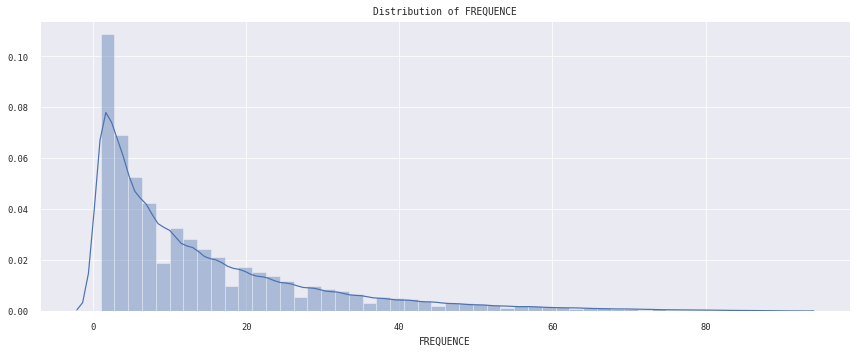

count           203,146.0000
mean              3,369.7634
std              12,281.8675
min                   0.0000
25%                   0.0000
50%                 267.0000
75%               2,925.0000
max             934,576.0000
Name: DATA_VOLUME, dtype: float64


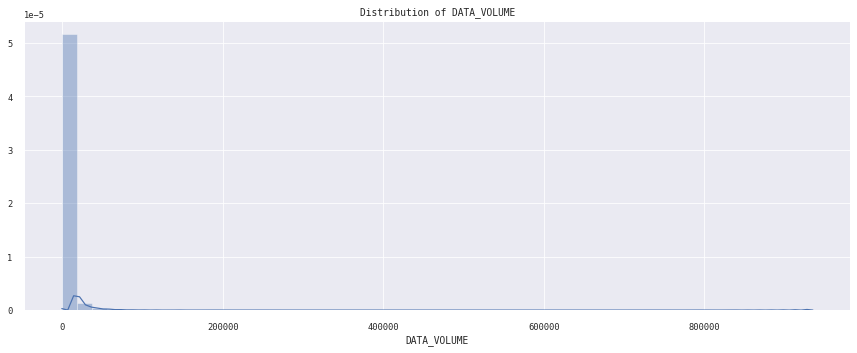

count           254,181.0000
mean                275.9176
std                 873.5930
min                   0.0000
25%                   5.0000
50%                  27.0000
75%                 155.0000
max              45,011.0000
Name: ON_NET, dtype: float64


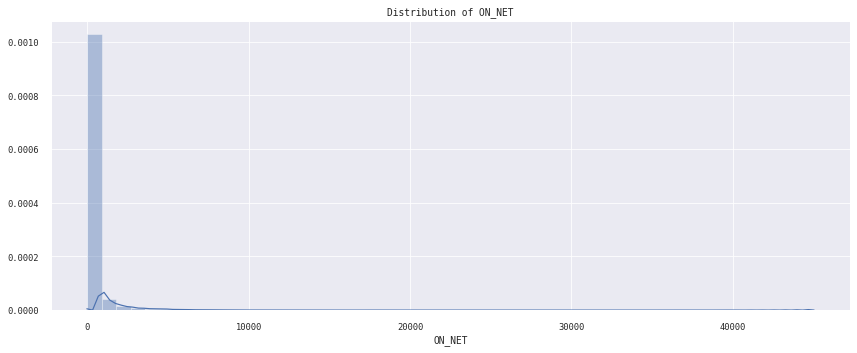

count           233,683.0000
mean                 95.5329
std                 204.7333
min                   0.0000
25%                   7.0000
50%                  29.0000
75%                  99.0000
max               6,788.0000
Name: ORANGE, dtype: float64


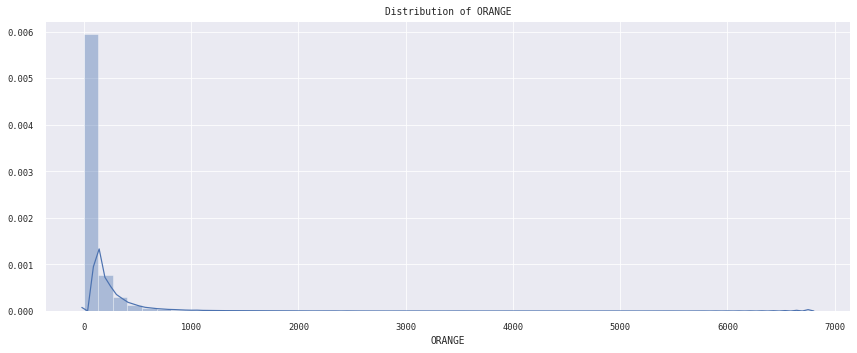

count           160,614.0000
mean                 23.1346
std                  63.0619
min                   0.0000
25%                   2.0000
50%                   6.0000
75%                  20.0000
max               2,758.0000
Name: TIGO, dtype: float64


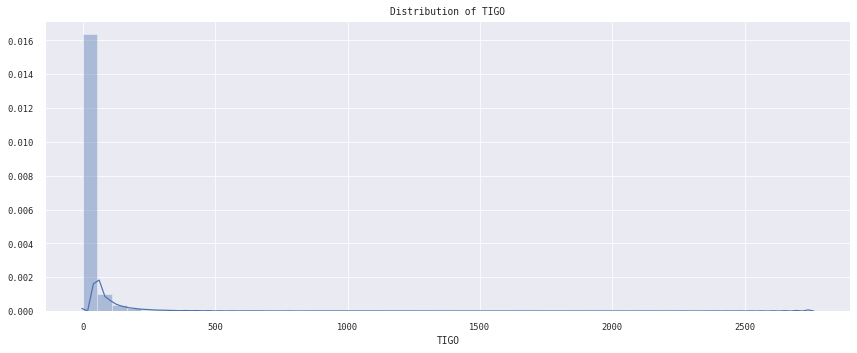

count           400,000.0000
mean                 28.0465
std                  22.2828
min                   1.0000
25%                   6.0000
50%                  24.0000
75%                  51.0000
max                  62.0000
Name: REGULARITY, dtype: float64


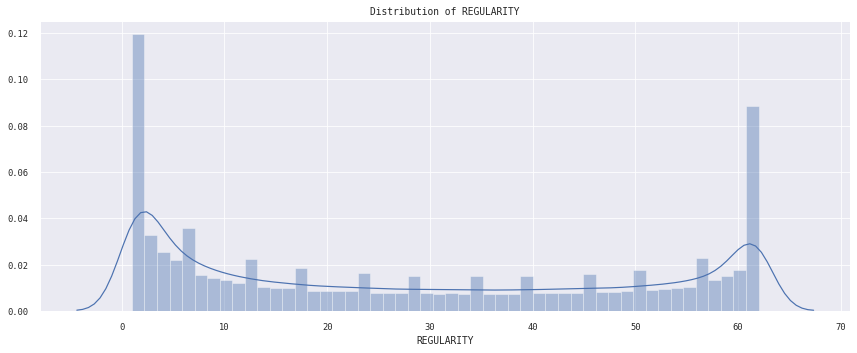

count           232,671.0000
mean                  9.2542
std                  12.3056
min                   1.0000
25%                   2.0000
50%                   5.0000
75%                  12.0000
max                 629.0000
Name: FREQ_TOP_PACK, dtype: float64


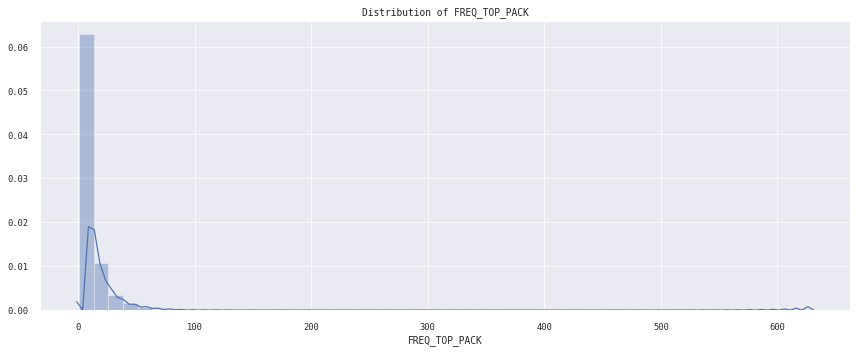

In [25]:
numeric_distribution_plot(train.drop('CHURN', axis=1))

### Checking for Outliers

In [26]:
# num_features = train.select_dtypes(include=np.number).columns
# for col in num_features.drop('CHURN'):
#     sns.boxplot(col, data=train)
#     plt.xlabel(col) # Set text for the x axisa

#     plt.show()

### Summary

* Most of the customers are based in the DAKAR Region
* Majority of the customers have spents over 2 years with the service provider i.e expresso
* Almost all numeric features are heavily skewed to the left, hence we may need to normalise them

## Feature transformation and Data preparation

In [27]:
from scipy.stats import skew,norm  # for some statistics

In [28]:
numeric = data.select_dtypes(include='number').columns
skew_features = data[numeric].apply(lambda x: skew(x)).sort_values(ascending=False)

high_skew = skew_features[skew_features > 0.5]
skew_index = high_skew.index

print("There are {} numerical features with Skew > 0.5 :".format(high_skew.shape[0]))
skewness = pd.DataFrame({'Skew' :high_skew})
skew_features.head(10)

There are 10 numerical features with Skew > 0.5 :


DATA_VOLUME                   35.8214
TIGO                          18.4773
ON_NET                        10.3886
ORANGE                         9.2925
FREQ_TOP_PACK                  5.6730
MONTANT                        4.9914
ARPU_SEGMENT                   4.6683
REVENUE                        4.6683
FREQUENCE_RECH                 2.8955
FREQUENCE                      2.4513
dtype: float64

### Lets take a look at some skewed features before and after log transformation

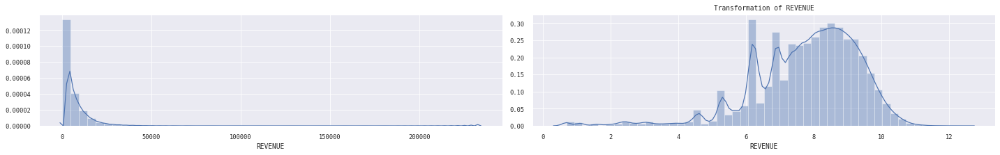

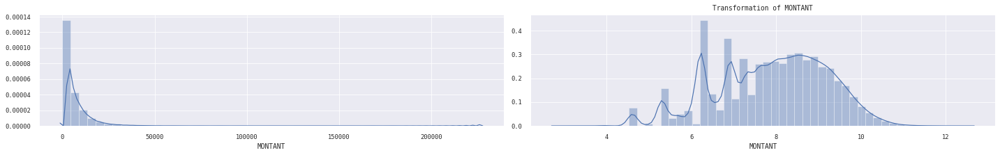

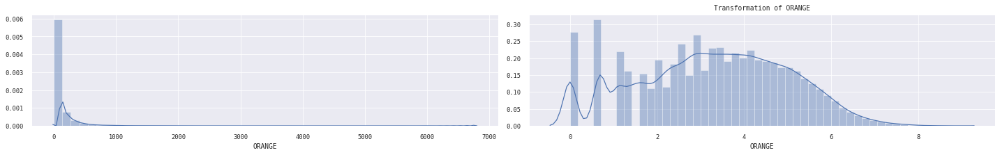

In [29]:
for col in ['REVENUE', 'MONTANT', 'ORANGE']:
    fig, ax = plt.subplots(1,2)

    #plot of normal feature on the first axis
    sns.distplot(train[col], ax=ax[0])

    #Transform the feature and plot on the second axis
    sns.distplot(np.log1p(train[col]), ax=ax[1])

    plt.tight_layout()
    plt.title("Transformation of {}".format(col))

In [30]:
# Normalize skewed features using log transformation
for column in skew_index:
    data[column] = np.log1p(data[column])

# Feature engineering

## Binning variables

In [31]:
data['FREQUENCE_RECH_BIN'] = pd.qcut(data['FREQUENCE_RECH'],q=[0, 0.25, 0.5, 0.75, 1.0])

In [32]:
data['MONTANT_BIN'] = pd.qcut(data['MONTANT'],q=[0, 0.25, 0.5, 0.75, 1.0])
data['REVENUE_BIN'] = pd.qcut(data['REVENUE'],q=[0, 0.25, 0.5, 0.75, 1.0])
data['FREQUENCE_BIN'] = pd.qcut(data['FREQUENCE'],q=[0, 0.25, 0.5, 0.75, 1.0])
data['ARPU_SEGMENT_BIN'] = pd.qcut(data['ARPU_SEGMENT'],q=[0, 0.25, 0.5, 0.75, 1.0])
data['DATA_VOLUME_BIN'] = pd.qcut(data['DATA_VOLUME'],q=[0, 0.25, 0.5, 0.75, 1.0])
data['FREQ_TOP_PACK_BIN'] = pd.qcut(data['FREQ_TOP_PACK'],q=[0, 0.25, 0.5, 0.75, 1.0])
data['FREQUENCE_BIN'] = pd.qcut(data['FREQUENCE'],q=[0, 0.25, 0.5, 0.75, 1.0])
data['REGULARITY_BIN'] = pd.qcut(data['REGULARITY'],q=[0, 0.25, 0.5, 0.75, 1.0])





In [33]:
data['ON_NET_BIN'] = pd.qcut(data['ON_NET'],q=[0, 0.25, 0.5, 0.75, 1.0])
data['ORANGE_BIN'] = pd.qcut(data['ORANGE'],q=[0, 0.25, 0.5, 0.75, 1.0])




## Variable Interaction

In [ ]:
data['MON_FREQ_RECH'] = data['MONTANT']*data['FREQUENCE_RECH']
data['MON_FREQ_RECH1'] = data['MONTANT']/data['FREQUENCE_RECH']
data['REV_ARPU_SEG'] = data['REVENUE']/data['ARPU_SEGMENT']
data['REV_FREQ'] = data['REVENUE']/data['FREQUENCE']
data['REV_DATA_VOL'] = data['REVENUE']/ data['DATA_VOLUME']
data['FREQ_REG'] = data['FREQ_TOP_PACK']/data['REGULARITY']
data['FREQ_DATA_VOL'] = data['FREQUENCE']* data['DATA_VOLUME']
data['ARPU_FREQ'] = data[ 'ARPU_SEGMENT']/data['FREQUENCE']
data['MON_REG'] = data['MONTANT']/data['REGULARITY']
data['REV_REG'] = data['REVENUE']/ data ['REGULARITY']
data['ARPU_REG'] = data['ARPU_SEGMENT']/ data['REGULARITY']
data['REV_FREQ_TOP_PACK'] = data ['REVENUE'] / data['FREQ_TOP_PACK']
data['REV_FREQ_RECH'] = data['REVENUE']/ data ['FREQUENCE_RECH']
data['Orange_Tigo'] = data['ORANGE']+data['TIGO']



## DAta Aggregation

In [53]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500000 entries, 0 to 499999
Data columns (total 25 columns):
 #   Column              Non-Null Count   Dtype   
---  ------              --------------   -----   
 0   REGION              500000 non-null  object  
 1   TENURE              500000 non-null  object  
 2   MONTANT             500000 non-null  float64 
 3   FREQUENCE_RECH      500000 non-null  float64 
 4   REVENUE             500000 non-null  float64 
 5   ARPU_SEGMENT        500000 non-null  float64 
 6   FREQUENCE           500000 non-null  float64 
 7   DATA_VOLUME         500000 non-null  float64 
 8   ON_NET              500000 non-null  float64 
 9   ORANGE              500000 non-null  float64 
 10  TIGO                500000 non-null  float64 
 11  REGULARITY          500000 non-null  int64   
 12  TOP_PACK            500000 non-null  object  
 13  FREQ_TOP_PACK       500000 non-null  float64 
 14  CHURN               500000 non-null  object  
 15  FREQUENCE_RECH_BI

In [73]:
dat = test.groupby(['user_id','REGION']).agg({'REVENUE':'max'})

In [74]:
dat.shape, train.shape

((60707, 1), (400000, 15))

In [47]:
dat = train.groupby(['REGION', 'TENURE', 'user_id'])['REVENUE'].mean()


In [48]:
dat

REGION       TENURE         user_id                                 
DAKAR        D 3-6 month    0120f2e54c4e236c955ff509fb4a65f185d2b881            10,228.0000
                            02ea8db6c4fb5d3dcef5c62544997e08241d3c19             2,525.0000
                            075056d2fb920836d6803c7f5e2be2bc5774b8b4            14,000.0000
                            1017faf694749c2952e6fabc0754672487d94113               719.0000
                            23ca2587895a781989394588af513d9070a82037                    nan
                            27249b476882b2f8d45f7e254ee9b8f0874fa9d8             1,990.0000
                            3877f5104de1ea92b42316f6b073457d24959798               996.0000
                            426f5920f6568bdd974a9ab25efc7ac0ae73ca6f             1,981.0000
                            53eaaa89ce1fb9835493695a1a00b25701e2f44c             3,352.0000
                            5889c628b28f4beb6cfdb9a58e0f71a704d10a04               731.0000
           

In [ ]:
#data.ON_NET.value_counts()

### Encoding Categorical features

In [ ]:
cat_features = data.select_dtypes(exclude=np.number).columns.drop('CHURN')

In [1]:
cat_features

NameError: ignored

In [ ]:
for col in cat_features:
    print('{} has {} unique categories'.format(col, data[col].nunique()))

REGION has 15 unique categories
TENURE has 8 unique categories
TOP_PACK has 113 unique categories
FREQUENCE_RECH_BIN has 4 unique categories
MONTANT_BIN has 4 unique categories
REVENUE_BIN has 4 unique categories
FREQUENCE_BIN has 4 unique categories
ARPU_SEGMENT_BIN has 4 unique categories
DATA_VOLUME_BIN has 4 unique categories
FREQ_TOP_PACK_BIN has 4 unique categories
REGULARITY_BIN has 4 unique categories
ON_NET_BIN has 4 unique categories
ORANGE_BIN has 4 unique categories


* We can One hot encode ```REGION``` and ```TENURE``` then Label Encode ```TOP_PACK```

In [ ]:
data = pd.get_dummies(columns= cat_features, data = data)

In [ ]:
data.head()

,MONTANT,FREQUENCE_RECH,REVENUE,ARPU_SEGMENT,FREQUENCE,DATA_VOLUME,ON_NET,ORANGE,TIGO,REGULARITY,FREQ_TOP_PACK,CHURN,MON_FREQ_RECH,MON_FREQ_RECH1,REV_ARPU_SEG,REV_FREQ,REV_DATA_VOL,FREQ_REG,FREQ_DATA_VOL,ARPU_FREQ,MON_REG,REV_REG,ARPU_REG,REV_FREQ_TOP_PACK,REV_FREQ_RECH,Orange_Tigo,REGION_DAKAR,REGION_DIOURBEL,REGION_FATICK,REGION_KAFFRINE,REGION_KAOLACK,REGION_KEDOUGOU,REGION_KOLDA,REGION_LOUGA,REGION_MATAM,REGION_REGION_NAN,REGION_SAINT-LOUIS,REGION_SEDHIOU,REGION_TAMBACOUNDA,REGION_THIES,REGION_ZIGUINCHOR,TENURE_D 3-6 month,TENURE_E 6-9 month,TENURE_F 9-12 month,TENURE_G 12-15 month,TENURE_H 15-18 month,TENURE_I 18-21 month,TENURE_J 21-24 month,TENURE_K > 24 month,TOP_PACK_1000=Unlimited7Day,TOP_PACK_200=Unlimited1Day,TOP_PACK_200=unlimited pilot auto,TOP_PACK_200F=10mnOnNetValid1H,TOP_PACK_301765007,TOP_PACK_305155009,TOP_PACK_500=Unlimited3Day,TOP_PACK_APANews_monthly,TOP_PACK_APANews_weekly,TOP_PACK_All-net 1000=5000;5d,TOP_PACK_All-net 1000F=(3000F On+3000F Off);5d,TOP_PACK_All-net 300=600;2d,TOP_PACK_All-net 5000= 20000off+20000on;30d,TOP_PACK_All-net 500F =2000F_AllNet_Unlimited,TOP_PACK_All-net 500F=1250F_AllNet_1250_Onnet;48h,TOP_PACK_All-net 500F=2000F;5d,TOP_PACK_All-net 500F=4000F ; 5d,TOP_PACK_All-net 600F= 3000F ;5d,TOP_PACK_CVM_100F_unlimited,TOP_PACK_CVM_100f=200 MB,TOP_PACK_CVM_200f=400MB,TOP_PACK_CVM_500f=2GB,TOP_PACK_CVM_On-net 1300f=12500,TOP_PACK_CVM_On-net 400f=2200F,TOP_PACK_CVM_on-net bundle 500=5000,"TOP_PACK_Data: 100 F=40MB,24H","TOP_PACK_Data: 200 F=100MB,24H","TOP_PACK_Data: 200F=1GB,24H","TOP_PACK_Data: 490F=Night,00H-08H","TOP_PACK_Data:1000F=2GB,30d","TOP_PACK_Data:1000F=5GB,7d","TOP_PACK_Data:1500F=3GB,30D","TOP_PACK_Data:1500F=SPPackage1,30d","TOP_PACK_Data:150F=SPPackage1,24H","TOP_PACK_Data:200F=Unlimited,24H","TOP_PACK_Data:3000F=10GB,30d","TOP_PACK_Data:300F=100MB,2d",TOP_PACK_Data:30Go_V 30_Days,"TOP_PACK_Data:490F=1GB,7d","TOP_PACK_Data:500F=2GB,24H",TOP_PACK_Data:50F=30MB_24H,"TOP_PACK_Data:700F=1.5GB,7d","TOP_PACK_Data:700F=SPPackage1,7d",TOP_PACK_Data:DailyCycle_Pilot_1.5GB,TOP_PACK_Data:New-GPRS_PKG_1500F,TOP_PACK_DataPack_Incoming,TOP_PACK_Data_EVC_2Go24H,TOP_PACK_EVC_100Mo,TOP_PACK_EVC_500=2000F,TOP_PACK_EVC_Jokko_Weekly,TOP_PACK_EVC_MEGA10000F,TOP_PACK_FIFA_TS_daily,TOP_PACK_FNF2 ( JAPPANTE),TOP_PACK_FNF_Youth_ESN,TOP_PACK_Facebook_MIX_2D,TOP_PACK_GPRS_3000Equal10GPORTAL,TOP_PACK_IVR Echat_Daily_50F,TOP_PACK_IVR Echat_Monthly_500F,TOP_PACK_IVR Echat_Weekly_200F,TOP_PACK_Incoming_Bonus_woma,TOP_PACK_Internat: 1000F_Zone_1;24H\t\t,TOP_PACK_Internat: 1000F_Zone_3;24h\t\t,TOP_PACK_Internat: 2000F_Zone_2;24H\t\t,TOP_PACK_Jokko_Daily,TOP_PACK_Jokko_Monthly,TOP_PACK_Jokko_Weekly,TOP_PACK_Jokko_promo,TOP_PACK_MIXT: 200mnoff net _unl on net _5Go;30d,TOP_PACK_MIXT: 390F=04HOn-net_400SMS_400 Mo;4h\t,"TOP_PACK_MIXT: 4900F= 10H on net_1,5Go ;30d",TOP_PACK_MIXT: 5000F=80Konnet_20Koffnet_250Mo;30d\t\t,"TOP_PACK_MIXT: 500F=75(SMS, ONNET, Mo)_1000FAllNet;24h\t\t",TOP_PACK_MIXT: 590F=02H_On-net_200SMS_200 Mo;24h\t\t,TOP_PACK_MIXT:10000F=10hAllnet_3Go_1h_Zone3;30d\t\t,TOP_PACK_MIXT:1000F=4250 Off net _ 4250F On net _100Mo; 5d,TOP_PACK_MIXT:500F= 2500F on net _2500F off net;2d,TOP_PACK_MROMO_TIMWES_OneDAY,TOP_PACK_MROMO_TIMWES_RENEW,TOP_PACK_Mixt 250F=Unlimited_call24H,TOP_PACK_Mixt : 500F=2500Fonnet_2500Foffnet ;5d,TOP_PACK_NEW_CLIR_PERMANENT_LIBERTE_MOBILE,TOP_PACK_NEW_CLIR_TEMPALLOWED_LIBERTE_MOBILE,TOP_PACK_New_YAKALMA_4_ALL,TOP_PACK_On net 200F= 3000F_10Mo ;24H,TOP_PACK_On net 200F=Unlimited _call24H,TOP_PACK_On-net 1000F=10MilF;10d,TOP_PACK_On-net 2000f_One_Month_100H; 30d,TOP_PACK_On-net 200F=60mn;1d,TOP_PACK_On-net 300F=1800F;3d,"TOP_PACK_On-net 500=4000,10d",TOP_PACK_On-net 500F_FNF;3d,TOP_PACK_Pilot_Youth1_290,TOP_PACK_Pilot_Youth4_490,TOP_PACK_Postpaid FORFAIT 10H Package,TOP_PACK_SUPERMAGIK_1000,TOP_PACK_SUPERMAGIK_5000,TOP_PACK_Staff_CPE_Rent,TOP_PACK_TOP_PACK_NAN,TOP_PACK_TelmunCRBT_daily,TOP_PACK_Twter_U2opia_Daily,TOP_PACK_Twter_U2opia_Monthly,TOP_PACK_Twter_U2opia_Weekly,TOP_PACK_V

In [ ]:
#Label encoding
#data['TOP_PACK']  = pd.factorize(data['TOP_PACK'])[0]

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500000 entries, 0 to 499999
Columns: 202 entries, MONTANT to ORANGE_BIN_(3.738, 8.823]
dtypes: float64(24), int64(1), object(1), uint8(176)
memory usage: 183.1+ MB


### Separating train and test

In [ ]:
train_df = data.loc[( data['CHURN'] != 'test')].reset_index(drop = True)
test_df = data.loc[( data['CHURN'] == 'test')].reset_index(drop = True)

In [ ]:
train_df.shape, test.shape

((400000, 202), (100000, 15))

In [ ]:
X = train_df.drop('CHURN', axis = 1)
y = train_df['CHURN'].apply(int)

### Baseline Model

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import log_loss

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,stratify = y,  random_state=42)

In [ ]:
lr = LogisticRegression()
rf = RandomForestClassifier()
gbm = GradientBoostingClassifier()
decision_tree = DecisionTreeClassifier()

In [ ]:
#lr.fit(X_train, y_train)
#rf.fit(X_train, y_train)
gbm.fit(X_train, y_train)
#decision_tree.fit(X_train, y_train)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=None, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [ ]:
#print('Logistic Regression Log loss: {}'.format(log_loss(y_test, lr.predict_proba(X_test)[:,1])))
#print('RandomForestClassifier Log loss: {}'.format(log_loss(y_test, rf.predict_proba(X_test)[:,1])))
print('GradientBoostingClassifier Log loss: {}'.format(log_loss(y_test, gbm.predict_proba(X_test)[:,1])))
print('DecisionTreeClassifier Log loss: {}'.format(log_loss(y_test, decision_tree.predict_proba(X_test)[:,1])))

Logistic Regression Log loss: 0.2648513210612782
RandomForestClassifier Log loss: 0.31406306175509136
GradientBoostingClassifier Log loss: 0.25436846421316567
DecisionTreeClassifier Log loss: 2.2643923401591177


* GradientBoostingClassifier seem to be performing best

In [ ]:
print('GradientBoostingClassifier Log loss: {}'.format(log_loss(y_test, gbm.predict_proba(X_test)[:,1])))


GradientBoostingClassifier Log loss: 0.253881576368635


## Feature Importance plot

#### RandomForest

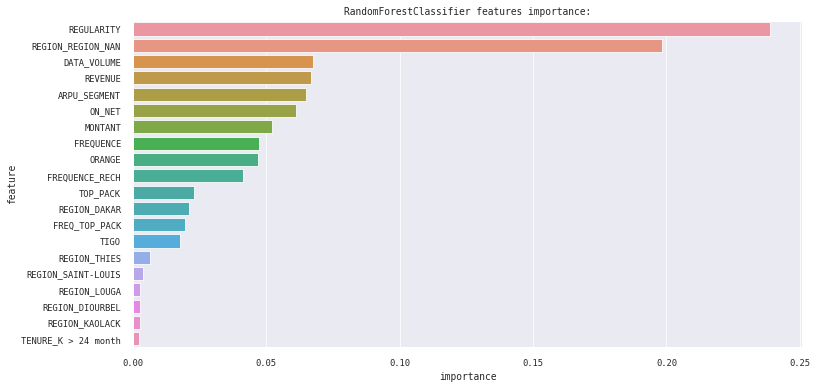

In [ ]:
feature_importance_df = pd.DataFrame(rf.feature_importances_, columns=['importance'])
feature_importance_df['feature'] = X.columns

plt.figure(figsize=(12, 6));
sns.barplot(x="importance", y="feature", data=feature_importance_df.sort_values(by = ['importance'], ascending = False).head(20))
plt.title('RandomForestClassifier features importance:');

#### GradientBoostingClassifier

In [ ]:
# feature_importance_df = pd.DataFrame(rf.feature_importances_, columns=['importance'])
# feature_importance_df['feature'] = X.columns

# plt.figure(figsize=(12, 6));
# sns.barplot(x="importance", y="feature", data=feature_importance_df.sort_values(by = ['importance'], ascending = False).head(20))
# plt.title('RandomForestClassifier features importance:');

### Predicting on the test set and Making Submission on zindi.

In [ ]:
test_x = test_df.drop('CHURN', axis = 1)

In [ ]:
prediction = gbm.predict_proba(test_x)[:, 1]

In [ ]:
sub['CHURN'] = prediction
sub.to_csv('submission7.csv', index =False)

In [ ]:
pip install catboost

     |████████████████████████████████| 65.9MB 45kB/s 


In [ ]:
from catboost import CatBoostClassifier


In [ ]:
cat = CatBoostClassifier(loss_function='Logloss', task_type='GPU', learning_rate=0.03, depth=6, l2_leaf_reg=3)

In [ ]:
#from sklearn.model_selection import GridSearchCV

In [ ]:
grid = {#'learning_rate': [0.03,0.04,0.05],
        #'depth': [4, 6,8],}
        'l2_leaf_reg': [1, 3, 5, ]}

grid_search_result = cat.grid_search(grid, 
                                       X=X_train, 
                                       y=y_train, 
                                       plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

bestTest = 0.2521979065
bestIteration = 983
0:	loss: 0.2521979	best: 0.2521979 (0)	total: 57.4s	remaining: 1m 54s
bestTest = 0.2520826263
bestIteration = 999
1:	loss: 0.2520826	best: 0.2520826 (1)	total: 1m 54s	remaining: 57.5s
bestTest = 0.2521126099
bestIteration = 996
2:	loss: 0.2521126	best: 0.2520826 (1)	total: 2m 53s	remaining: 0us
Estimating final quality...


In [ ]:
grid_search_result

{'cv_results': defaultdict(list,
             {'iterations': [0,
               1,
               2,
               3,
               4,
               5,
               6,
               7,
               8,
               9,
               10,
               11,
               12,
               13,
               14,
               15,
               16,
               17,
               18,
               19,
               20,
               21,
               22,
               23,
               24,
               25,
               26,
               27,
               28,
               29,
               30,
               31,
               32,
               33,
               34,
               35,
               36,
               37,
               38,
               39,
               40,
               41,
               42,
               43,
               44,
               45,
               46,
               47,
               48,
               49,
             

In [ ]:
gscv = GridSearchCV(estimator=cat, param_grid=grid, cv =5)

In [ ]:
gscv.fit(X_train, y_train)

Streaming output truncated to the last 5000 lines.
125:	learn: 0.2508166	total: 1.7s	remaining: 11.8s
126:	learn: 0.2507991	total: 1.72s	remaining: 11.8s
127:	learn: 0.2507777	total: 1.73s	remaining: 11.8s
128:	learn: 0.2507679	total: 1.74s	remaining: 11.7s
129:	learn: 0.2507578	total: 1.75s	remaining: 11.7s
130:	learn: 0.2507283	total: 1.76s	remaining: 11.7s
131:	learn: 0.2506976	total: 1.78s	remaining: 11.7s
132:	learn: 0.2506560	total: 1.79s	remaining: 11.7s
133:	learn: 0.2506301	total: 1.8s	remaining: 11.7s
134:	learn: 0.2506195	total: 1.82s	remaining: 11.6s
135:	learn: 0.2506014	total: 1.83s	remaining: 11.6s
136:	learn: 0.2505845	total: 1.84s	remaining: 11.6s
137:	learn: 0.2505679	total: 1.86s	remaining: 11.6s
138:	learn: 0.2505555	total: 1.87s	remaining: 11.6s
139:	learn: 0.2505060	total: 1.88s	remaining: 11.6s
140:	learn: 0.2504868	total: 1.9s	remaining: 11.6s
141:	learn: 0.2504585	total: 1.91s	remaining: 11.6s
142:	learn: 0.2504394	total: 1.93s	remaining: 11.5s
143:	learn: 0.25

In [ ]:
#parameter tuning
cat = CatBoostClassifier(loss_function='Logloss', task_type='GPU', learning_rate=0.03, depth=6, l2_leaf_reg=3, )

cat.fit(X_train, y_train, eval_set=(X_test, y_test),plot=True)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6430425	test: 0.6432642	best: 0.6432642 (0)	total: 15.9ms	remaining: 15.8s
1:	learn: 0.5997940	test: 0.6002274	best: 0.6002274 (1)	total: 30.5ms	remaining: 15.2s
2:	learn: 0.5616244	test: 0.5622361	best: 0.5622361 (2)	total: 45.2ms	remaining: 15s
3:	learn: 0.5282078	test: 0.5289806	best: 0.5289806 (3)	total: 59.8ms	remaining: 14.9s
4:	learn: 0.4979663	test: 0.4988970	best: 0.4988970 (4)	total: 74.3ms	remaining: 14.8s
5:	learn: 0.4718111	test: 0.4728540	best: 0.4728540 (5)	total: 88.9ms	remaining: 14.7s
6:	learn: 0.4474454	test: 0.4485652	best: 0.4485652 (6)	total: 104ms	remaining: 14.8s
7:	learn: 0.4277287	test: 0.4289121	best: 0.4289121 (7)	total: 119ms	remaining: 14.8s
8:	learn: 0.4093415	test: 0.4105732	best: 0.4105732 (8)	total: 134ms	remaining: 14.7s
9:	learn: 0.3937432	test: 0.3950115	best: 0.3950115 (9)	total: 148ms	remaining: 14.7s
10:	learn: 0.3792760	test: 0.3805833	best: 0.3805833 (10)	total: 163ms	remaining: 14.6s
11:	learn: 0.3667548	test: 0.3680815	best: 0.368

In [ ]:
#added new featuew through interaction
cat = CatBoostClassifier(loss_function='Logloss', task_type='GPU' )

cat.fit(X_train, y_train, eval_set=(X_test, y_test),plot=True)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.04361
0:	learn: 0.6233462	test: 0.6236897	best: 0.6236897 (0)	total: 20.4ms	remaining: 20.4s
1:	learn: 0.5649837	test: 0.5656204	best: 0.5656204 (1)	total: 35.8ms	remaining: 17.8s
2:	learn: 0.5139976	test: 0.5148066	best: 0.5148066 (2)	total: 50.8ms	remaining: 16.9s
3:	learn: 0.4739821	test: 0.4749756	best: 0.4749756 (3)	total: 66.4ms	remaining: 16.5s
4:	learn: 0.4407076	test: 0.4418368	best: 0.4418368 (4)	total: 81.6ms	remaining: 16.2s
5:	learn: 0.4131344	test: 0.4143763	best: 0.4143763 (5)	total: 96.7ms	remaining: 16s
6:	learn: 0.3891689	test: 0.3904721	best: 0.3904721 (6)	total: 112ms	remaining: 15.8s
7:	learn: 0.3695148	test: 0.3708439	best: 0.3708439 (7)	total: 128ms	remaining: 15.8s
8:	learn: 0.3534237	test: 0.3547718	best: 0.3547718 (8)	total: 143ms	remaining: 15.7s
9:	learn: 0.3398392	test: 0.3411881	best: 0.3411881 (9)	total: 158ms	remaining: 15.6s
10:	learn: 0.3285113	test: 0.3298617	best: 0.3298617 (10)	total: 175ms	remaining: 15.7s
11:	learn: 0.318896

In [ ]:
prediction = cat.predict_proba(test_x)[:, 1]

sub['CHURN'] = prediction
sub.to_csv('submission9.csv', index =False)

In [ ]:
print('Hello')

In [ ]:
cat.fit(X_train, y_train, eval_set=(X_test, y_test),plot=True)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.044108
0:	learn: 0.6221617	test: 0.6223340	best: 0.6223340 (0)	total: 23.5ms	remaining: 23.4s
1:	learn: 0.5663678	test: 0.5666195	best: 0.5666195 (1)	total: 42.3ms	remaining: 21.1s
2:	learn: 0.5168044	test: 0.5171666	best: 0.5171666 (2)	total: 61.1ms	remaining: 20.3s
3:	learn: 0.4754402	test: 0.4759057	best: 0.4759057 (3)	total: 79.7ms	remaining: 19.8s
4:	learn: 0.4416896	test: 0.4422133	best: 0.4422133 (4)	total: 98.4ms	remaining: 19.6s
5:	learn: 0.4127394	test: 0.4132819	best: 0.4132819 (5)	total: 117ms	remaining: 19.4s
6:	learn: 0.3895837	test: 0.3901489	best: 0.3901489 (6)	total: 136ms	remaining: 19.3s
7:	learn: 0.3696478	test: 0.3702246	best: 0.3702246 (7)	total: 155ms	remaining: 19.2s
8:	learn: 0.3532356	test: 0.3538090	best: 0.3538090 (8)	total: 174ms	remaining: 19.1s
9:	learn: 0.3396274	test: 0.3401986	best: 0.3401986 (9)	total: 193ms	remaining: 19.1s
10:	learn: 0.3281994	test: 0.3287663	best: 0.3287663 (10)	total: 211ms	remaining: 19s
11:	learn: 0.318550

In [ ]:
prediction = cat.predict_proba(test_x)[:, 1]


In [ ]:
prediction = cat.predict_proba(test_x)[:, 1]

sub['CHURN'] = prediction
sub.to_csv('submission8.csv', index =False)